In [ ]:
from google.colab import files
files.upload()

In [ ]:
!mkdir ~/.kaggle
!cp ./kaggle.json ~/.kaggle/kaggle.json
!chmod 600 ~/.kaggle/kaggle.json

In [23]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("splcher/animefacedataset")

print("Path to dataset files:", path)

Using Colab cache for faster access to the 'animefacedataset' dataset.
Path to dataset files: /kaggle/input/animefacedataset


In [24]:
!pip install torchviz graphviz

In [25]:

import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import torch.nn.functional as F



torch.use_deterministic_algorithms(False)

In [26]:

dataroot = path
workers = 4

batch_size = 64
image_size = 64

chann_color = 3 #input chan
chann_lat =300  #latent vector size

chann_gen = 64 # number of last channel in generator befor go to rgb
chann_dis = 64 # chann params in discriminator
epochs = 15
lrd = 0.00005
lrg = 0.0001
beta1 = 0.5

ngpu = 1

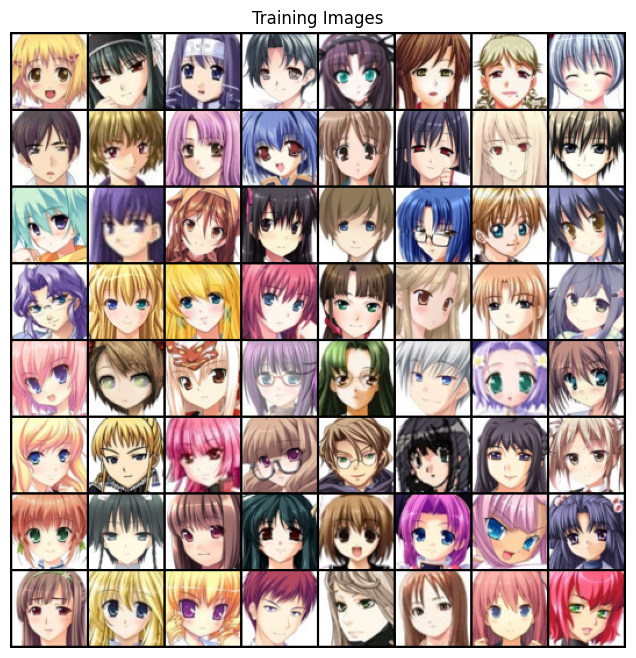

In [27]:

dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)


device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [28]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [29]:
class SelfAttention(nn.Module):
    def __init__(self, in_channels):
        super().__init__()
        Conv1x1 = (lambda c_in, c_out: nn.Conv2d(c_in, c_out, 1, 1, 0, bias=False))
        self.q = Conv1x1(in_channels, in_channels // 8)
        self.k = Conv1x1(in_channels, in_channels // 8)
        self.v = Conv1x1(in_channels, in_channels)
        self.gamma = nn.Parameter(torch.zeros(1))

    def forward(self, x):
        b, c, h, w = x.size()
        n = h * w
        q = self.q(x).view(b, -1, n).permute(0, 2, 1)
        k = self.k(x).view(b, -1, n)
        attn = torch.bmm(q, k)
        attn = F.softmax(attn, dim=-1)
        v = self.v(x).view(b, c, n)
        out = torch.bmm(v, attn.permute(0, 2, 1)).view(b, c, h, w)
        return self.gamma * out + x


In [30]:
# Generator Code 64x64

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            self.ConvTransLayer(chann_lat,      chann_gen*8, 4, 1, 0),  # 1 -> 4
            self.ConvTransLayer(chann_gen*8,   chann_gen*4, 4, 2, 1),  # 4 -> 8
            SelfAttention(chann_gen*4),

            self.ConvTransLayer(chann_gen*4,   chann_gen*2,  4, 2, 1),  # 8 -> 16
            self.ConvTransLayer(chann_gen*2,    chann_gen,  4, 2, 1),  # 16 -> 32

            nn.ConvTranspose2d(chann_gen, chann_color, 4, 2, 1, bias=False),  # 128 -> 256
            nn.Tanh()
        )

    def ConvTransLayer(self,in_chan,out_chan,k_size,stride=1,padding=0):
        return nn.Sequential(
            nn.ConvTranspose2d(in_chan, out_chan, k_size, stride, padding, output_padding=0, bias=False),
            nn.BatchNorm2d(out_chan),
            nn.PReLU(out_chan)
        )

    def forward(self, input):
        return self.main(input)


In [31]:

netG = Generator(ngpu).to(device)


if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

netG.apply(weights_init)

print(netG)

Generator(
  (main): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(300, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): PReLU(num_parameters=512)
    )
    (1): Sequential(
      (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): PReLU(num_parameters=256)
    )
    (2): SelfAttention(
      (q): Conv2d(256, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (k): Conv2d(256, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (v): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
    )
    (3): Sequential(
      (0): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     

In [32]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(

            nn.Conv2d(chann_color, chann_dis, 4, 2, 1, bias=False),
            nn.PReLU(chann_dis),
            SelfAttention(chann_dis),

            self.ConvLayer(chann_dis,       chann_dis*2, 4, 2, 1),
            self.ConvLayer(chann_dis*2,     chann_dis*4, 4, 2, 1),

            self.ConvLayer(chann_dis*4,     chann_dis*8,  4, 2, 1),


            nn.Conv2d(chann_dis * 8, 1, 4, 1, 0, bias=False)
        )

    def ConvLayer(self,in_chan,out_chan,k_size,stride=1,padding=0):
        return nn.Sequential(
            nn.Conv2d(in_chan, out_chan, k_size, stride, padding, bias=False),
            nn.BatchNorm2d(out_chan),

            nn.PReLU(out_chan)
        )

    def forward(self, input):
        return self.main(input)


In [33]:

netD = Discriminator(ngpu).to(device)


if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))


netD.apply(weights_init)


print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): PReLU(num_parameters=64)
    (2): SelfAttention(
      (q): Conv2d(64, 8, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (k): Conv2d(64, 8, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (v): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
    )
    (3): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): PReLU(num_parameters=128)
    )
    (4): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): PReLU(num_parameters=256)
    )
    (5): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bia

In [34]:

criterion = nn.BCEWithLogitsLoss()

fixed_noise = torch.randn(64, chann_lat, 1, 1, device=device)


real_label = 1
fake_label = 0


optimizerD = optim.Adam(netD.parameters(), lr=lrd, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lrg, betas=(beta1, 0.999))


In [35]:
# Training Loop


img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(epochs):

    for i, data in enumerate(dataloader, 0):


        netD.zero_grad()

        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, device=device)

        output = netD(real_cpu).view(-1)

        errD_real = criterion(output, torch.ones_like(output))

        errD_real.backward()
        D_x = output.mean().item()


        noise = torch.randn(b_size, chann_lat, 1, 1, device=device)
        fake  = netG(noise)

        label.fill_(fake_label)

        output = netD(fake.detach()).view(-1)

        errD_fake = criterion(output, torch.zeros_like(output))

        errD_fake.backward()
        D_G_z1 = output.mean().item()

        errD = errD_real + errD_fake

        optimizerD.step()


        netG.zero_grad()
        label.fill_(real_label)

        output = netD(fake).view(-1)

        errG = criterion(output, torch.ones_like(output))

        errG.backward()
        D_G_z2 = output.mean().item()

        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))


        G_losses.append(errG.item())
        D_losses.append(errD.item())


        if (iters % 500 == 0) or ((epoch == epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/15][0/994]	Loss_D: 1.7394	Loss_G: 1.2418	D(x): 0.5256	D(G(z)): 0.5662 / -0.7406
[0/15][50/994]	Loss_D: 0.2098	Loss_G: 5.1112	D(x): 5.8258	D(G(z)): -2.6149 / -5.0992
[0/15][100/994]	Loss_D: 0.1569	Loss_G: 6.6348	D(x): 7.1467	D(G(z)): -3.2110 / -6.6325
[0/15][150/994]	Loss_D: 0.1387	Loss_G: 7.6199	D(x): 6.6065	D(G(z)): -5.0187 / -7.6179
[0/15][200/994]	Loss_D: 0.2852	Loss_G: 4.9074	D(x): 3.2688	D(G(z)): -5.0429 / -4.8635
[0/15][250/994]	Loss_D: 0.2477	Loss_G: 4.7321	D(x): 3.7017	D(G(z)): -2.5860 / -4.7161
[0/15][300/994]	Loss_D: 0.6151	Loss_G: 3.0080	D(x): 1.8349	D(G(z)): -2.0964 / -2.9165
[0/15][350/994]	Loss_D: 0.2049	Loss_G: 4.2370	D(x): 4.6250	D(G(z)): -2.3447 / -4.2163
[0/15][400/994]	Loss_D: 0.5639	Loss_G: 1.6075	D(x): 1.4176	D(G(z)): -3.6499 / -1.2555
[0/15][450/994]	Loss_D: 0.2804	Loss_G: 4.7448	D(x): 3.3896	D(G(z)): -3.4214 / -4.7272
[0/15][500/994]	Loss_D: 0.5495	Loss_G: 3.3369	D(x): 1.5232	D(G(z)): -3.2872 / -3.2685
[0/15][550/994]	Loss_D: 0.4761	L

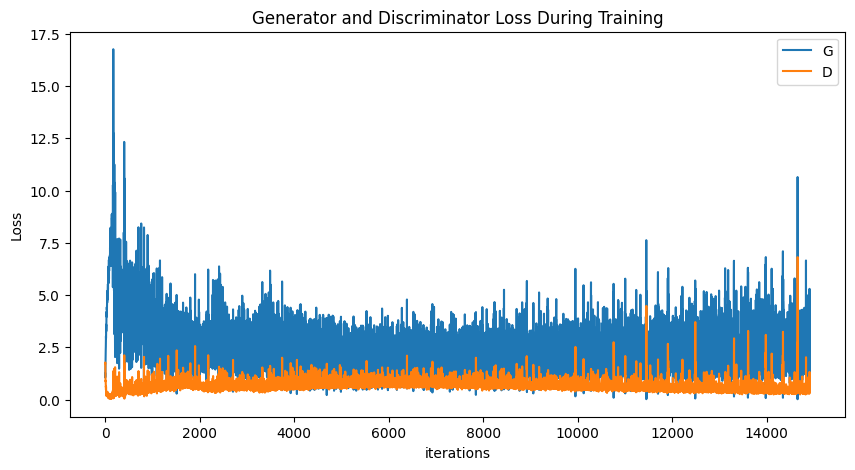

In [36]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [37]:
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 50  # MB

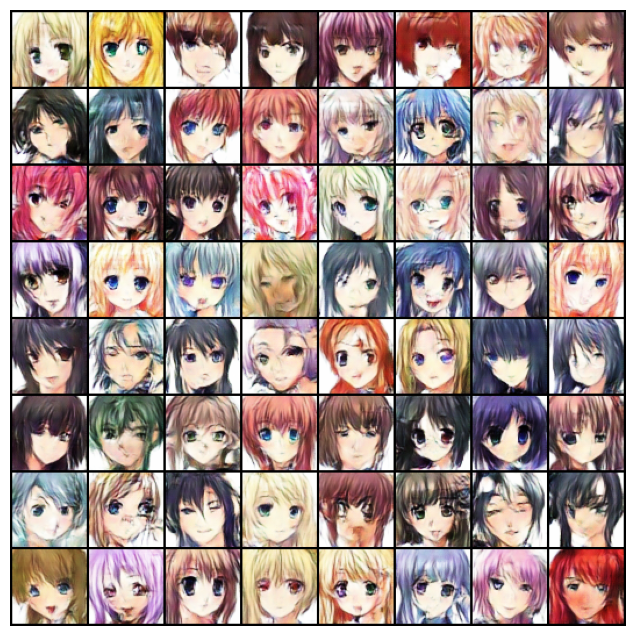

In [38]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [39]:

from torchviz import make_dot

x = torch.randn(1, 3, 64, 64).to(device)
y = netD(x)
dot = make_dot(y, params=dict(list(netD.named_parameters())))
dot.format = "png"
dot.render("netD_comp_graph")


'netD_comp_graph.png'

In [40]:

z_dim = 300
x = torch.randn(1, z_dim, 1, 1).to(device)


y = netG(x)

dot = make_dot(y, params=dict(list(netG.named_parameters())))
dot.format = "png"
dot.render("netG_comp_graph")


'netG_comp_graph.png'

In [41]:
!pip -q install torch-fidelity clean-fid


In [52]:
#evaluation
import os, math, torch
import torchvision.utils as vutils
from torch_fidelity import calculate_metrics



fake_dir = "/kaggle/working/fakes_anime64"
os.makedirs(fake_dir, exist_ok=True)

def export_fakes(G, out_dir, n_images=50000, batch_size=128, device="cuda"):
    G.eval()
    saved = 0
    with torch.no_grad():
        while saved < n_images:
            b = min(batch_size, n_images - saved)
            z = torch.randn(b, chann_lat, 1, 1, device=device)
            x = G(z)
            x = (x.clamp(-1, 1) + 1) / 2
            for i in range(b):
                vutils.save_image(x[i], os.path.join(out_dir, f"{saved+i:06d}.png"))
            saved += b


export_fakes(netG, fake_dir, n_images=10000, batch_size=64, device=device)


In [48]:
from PIL import Image
import os

real_dir = "/kaggle/input/animefacedataset/images"
resized_real_dir = "/kaggle/working/real_images_resized"
os.makedirs(resized_real_dir, exist_ok=True)

for filename in os.listdir(real_dir):
    img_path = os.path.join(real_dir, filename)
    if os.path.isfile(img_path):
        try:
            img = Image.open(img_path)
            img_resized = img.resize((64, 64), Image.Resampling.LANCZOS)
            img_resized.save(os.path.join(resized_real_dir, filename))
        except Exception as e:
            print(f"Error processing image {filename}: {e}")


In [49]:
from torch_fidelity import calculate_metrics
import torch

metrics = calculate_metrics(
    input1=resized_real_dir,
    input2=fake_dir,
    cuda=torch.cuda.is_available(),
    isc=True,
    fid=True,
    verbose=True,
    batch_size=64
)
print(metrics)

Creating feature extractor "inception-v3-compat" with features ['logits_unbiased', '2048']
Extracting features from input1
Looking for samples non-recursivelty in "/kaggle/working/real_images_resized" with extensions png,jpg,jpeg
Found 63565 samples, some are lossy-compressed - this may affect metrics
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "/kaggle/working/fakes_anime64" with extensions png,jpg,jpeg
Found 10000 samples
Processing samples
Inception Score: 2.554036457270067 ± 0.017016749752

{'inception_score_mean': 2.554036457270067, 'inception_score_std': 0.017016749752066716, 'frechet_inception_distance': 78.64312885854096}


Frechet Inception Distance: 78.64312885854096


In [50]:
import shutil

In [51]:
shutil.rmtree(resized_real_dir)